# Taller 02 - Clasificación
1. Realizar exploracion del conjunto de datos
2. Extraer características usando modelo pre-entrenado (ResNet50, Mobilnet...)
3. Entrenar cabeza de clasificación (Recomendado: AutoGluon)
4. Evaluar desempeño del modelo 

In [1]:
# Importar las librerías necesarias
import os
import matplotlib.pyplot as plt
import glob
import numpy as np
import pandas as pd
from PIL import Image

import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array


In [2]:
# Valisar si TensorFlow está utilizando la GPU
print("Dispositivos disponibles:", tf.config.list_physical_devices('GPU'))

Dispositivos disponibles: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Exploración del conjunto de datos

In [3]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

def mostrar_imagenes_por_clase(data_dir, images_per_class=4, sort_mode='sorted'):
    """
    Muestra una grilla de imágenes por clase.
    
    Args:
        data_dir (str): Ruta al directorio con subdirectorios por clase.
        images_per_class (int): Número de imágenes a mostrar por clase.
        sort_mode (str): 'sorted' o 'random' para ordenar clases.
    """
    # Cargar clases
    classes = [d for d in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, d))]
    if sort_mode == 'sorted':
        classes = sorted(classes)
    elif sort_mode == 'random':
        random.shuffle(classes)

    print(f"Clases encontradas ({len(classes)}):", classes)

    # Crear subplots
    fig, axes = plt.subplots(len(classes), images_per_class, figsize=(images_per_class * 3, len(classes) * 3))
    if len(classes) == 1:
        axes = [axes]  # evitar errores si solo hay una clase

    for row_idx, clase in enumerate(classes):
        class_path = os.path.join(data_dir, clase)
        imgs = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        
        for col_idx in range(images_per_class):
            ax = axes[row_idx][col_idx] if len(classes) > 1 else axes[col_idx]
            if col_idx < len(imgs):
                img_path = os.path.join(class_path, imgs[col_idx])
                im = Image.open(img_path)
                ax.imshow(im)
                if col_idx == 0:
                    ax.set_ylabel(clase, fontsize=12)
            ax.axis('off')

    plt.tight_layout()
    plt.show()

Clases encontradas (40): ['0003', '0021', '0004', '0038', '0032', '0018', '0010', '0035', '0012', '0036', '0020', '0005', '0030', '0000', '0022', '0009', '0019', '0011', '0008', '0015', '0007', '0014', '0006', '0001', '0029', '0037', '0002', '0027', '0034', '0033', '0028', '0024', '0016', '0025', '0026', '0023', '0031', '0039', '0013', '0017']


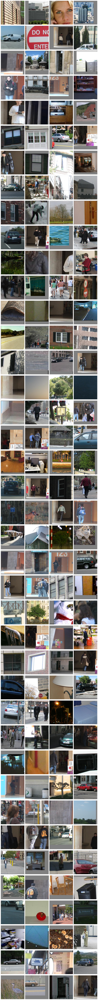

In [4]:
# Cambia sort_mode a 'sorted' si prefieres orden alfabético.
mostrar_imagenes_por_clase('data/labelme/train', images_per_class=4, sort_mode='random')

In [5]:
# Cargar el modelo preentrenado ResNet50 para extracción de features (sin capa superior)
resnet_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
resnet_model.trainable = False

def extract_features(img_path, target_size=(224, 224)):
    img = load_img(img_path, target_size=target_size)
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    features = resnet_model.predict(x)
    return features.flatten()

2025-04-21 22:06:52.425451: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M3 Pro
2025-04-21 22:06:52.425487: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 18.00 GB
2025-04-21 22:06:52.425498: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 6.00 GB
2025-04-21 22:06:52.425534: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-04-21 22:06:52.425548: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [6]:
# Directorio donde se encuentran las imágenes (estructura: data/labelme/train/clase/imagen)
data_dir = 'data/labelme/train'
image_paths = []
labels = []

In [7]:
# Asumiendo que cada subcarpeta en data/labelme/train es una clase
classes = [d for d in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, d))]
for class_name in classes:
    class_folder = os.path.join(data_dir, class_name)
    for ext in ('*.jpg', '*.jpeg', '*.png'):
        for img_path in glob.glob(os.path.join(class_folder, ext)):
            image_paths.append(img_path)
            labels.append(class_name)

# Crear DataFrame inicial con las rutas e labels
df = pd.DataFrame({'image': image_paths, 'label': labels})
print("Número total de imágenes:", len(df))

Número total de imágenes: 40000


Distribución de clases:
0003    1000
0004    1000
0000    1000
0036    1000
0009    1000
0031    1000
0030    1000
0037    1000
0008    1000
0001    1000
0006    1000
0039    1000
0024    1000
0023    1000
0015    1000
0012    1000
0013    1000
0014    1000
0022    1000
0038    1000
0007    1000
0021    1000
0018    1000
0032    1000
0035    1000
0034    1000
0033    1000
0005    1000
0002    1000
0020    1000
0027    1000
0026    1000
0011    1000
0029    1000
0016    1000
0028    1000
0017    1000
0010    1000
0019    1000
0025    1000
Name: label, dtype: int64


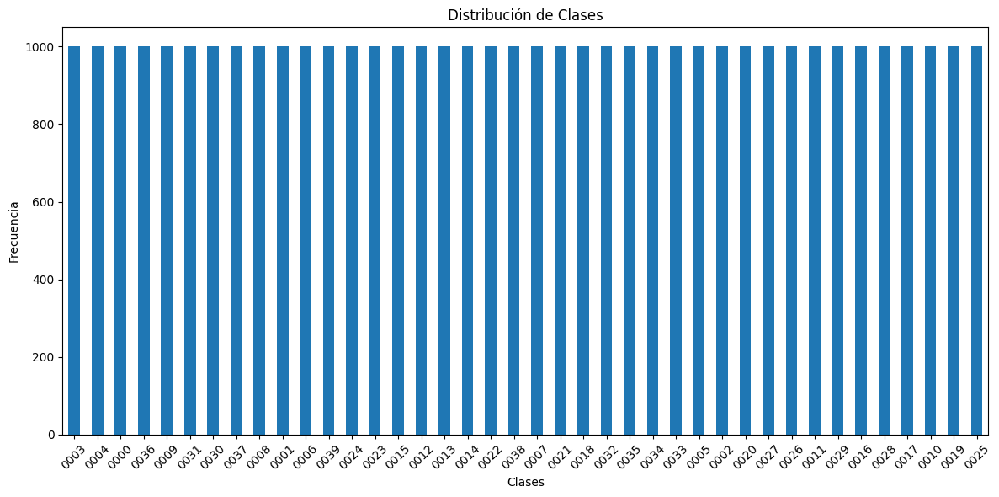

In [8]:
# Ver la distribución de las etiquetas en el DataFrame
print("Distribución de clases:")
print(df['label'].value_counts())

plt.figure(figsize=(12, 6))
df['label'].value_counts().plot(kind='bar')
plt.title("Distribución de Clases")
plt.xlabel("Clases")
plt.ylabel("Frecuencia")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [9]:
import contextlib
import sys
import ipywidgets as widgets
from IPython.display import display

@contextlib.contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:
            yield
        finally:
            sys.stdout = old_stdout

# Crear barra de progreso GUI
progress = widgets.IntProgress(
    value=0,
    min=0,
    max=len(df),
    description='Extrayendo:',
    bar_style='info',  # 'success', 'info', 'warning', 'danger' o ''
    orientation='horizontal'
)
display(progress)

# Extraer features para cada imagen
features_list = []
for path in df['image'].values:
    with suppress_stdout():  # evita output molesto
        feat = extract_features(path)
    features_list.append(feat)
    progress.value += 1

IntProgress(value=0, bar_style='info', description='Extrayendo:', max=40000)

2025-04-21 22:06:54.273498: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


In [10]:
# Convertir la lista a DataFrame
features_df = pd.DataFrame(features_list)
print("Shape de las features extraídas:", features_df.shape)


Shape de las features extraídas: (40000, 2048)


In [11]:
# Concatenar (reseteamos índices para asegurar alineación)
df = pd.concat([df.reset_index(drop=True), features_df.reset_index(drop=True)], axis=1)
print("DataFrame final shape:", df.shape)
print(df.head())

DataFrame final shape: (40000, 2050)
                                image label         0         1         2  \
0  data/labelme/train/0003/003301.jpg  0003  0.020444  0.250875  0.000000   
1  data/labelme/train/0003/003467.jpg  0003  0.061238  0.008967  0.218246   
2  data/labelme/train/0003/003473.jpg  0003  0.077411  0.237053  0.028446   
3  data/labelme/train/0003/003315.jpg  0003  0.009786  0.067125  0.111026   
4  data/labelme/train/0003/003329.jpg  0003  0.183469  0.664342  0.205702   

          3         4         5         6         7  ...      2038      2039  \
0  0.035674  0.000000  0.000000  0.164670  0.224549  ...  0.026664  0.000000   
1  1.963656  0.019548  0.049982  0.115279  0.155090  ...  0.221277  0.188732   
2  6.031929  0.253334  0.082898  0.369942  0.000000  ...  0.109875  0.000000   
3  0.000000  0.027975  0.000000  0.417802  0.040950  ...  0.000000  0.000000   
4  0.689198  0.131467  0.002411  0.181523  1.016502  ...  0.091185  0.298116   

       2040      20

In [12]:
# Verificar que features_df tiene la forma esperada
print("Shape de features_df:", features_df.shape)
print("Primeras filas de features_df:")
print(features_df.head())

# Verificar que al concatenar con df se han agregado las nuevas columnas
print("Información del DataFrame final:")
print(df.info())

# Para ver estadísticas resumidas de las columnas numéricas (features)
print("Descripción de los features:")
print(df.describe())

Shape de features_df: (40000, 2048)
Primeras filas de features_df:
       0         1         2         3         4         5         6     \
0  0.020444  0.250875  0.000000  0.035674  0.000000  0.000000  0.164670   
1  0.061238  0.008967  0.218246  1.963656  0.019548  0.049982  0.115279   
2  0.077411  0.237053  0.028446  6.031929  0.253334  0.082898  0.369942   
3  0.009786  0.067125  0.111026  0.000000  0.027975  0.000000  0.417802   
4  0.183469  0.664342  0.205702  0.689198  0.131467  0.002411  0.181523   

       7         8         9     ...      2038      2039      2040      2041  \
0  0.224549  0.275296  1.437013  ...  0.026664  0.000000  0.000000  0.015194   
1  0.155090  1.556684  0.349047  ...  0.221277  0.188732  0.291664  0.000000   
2  0.000000  0.000000  0.353691  ...  0.109875  0.000000  0.000000  0.646801   
3  0.040950  0.769531  2.121030  ...  0.000000  0.000000  0.249240  0.018887   
4  1.016502  1.740586  0.514134  ...  0.091185  0.298116  0.418232  0.000000   

 

## Entrenamiento de la cabeza de clasificación con AutoGluon
- Utilizaremos AutoGluon TabularPredictor para entrenar un clasificador usando las features extraídas. En este ejemplo se utilizan todas las columnas (salvo 'image' y 'label') como features.

*Nota*: AutoGluon es compatible hasta con scikit-learn==1.2.2.

In [13]:
from autogluon.tabular import TabularPredictor
from sklearn.model_selection import train_test_split

# Definir la lista de columnas que serán las features (todas excepto 'image' y 'label')
feature_columns = df.columns.difference(['image', 'label']).tolist()
label = 'label'
print("Feature columns:", feature_columns)


Feature columns: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 21

In [14]:
# Dividir en conjuntos de entrenamiento y validación (ej. 80/20), estratificando por label
train_df, val_df = train_test_split(df, test_size=0.2, random_state=42, stratify=df[label])
print("Imágenes de entrenamiento:", len(train_df))
print("Imágenes de validación:", len(val_df))

Imágenes de entrenamiento: 32000
Imágenes de validación: 8000


In [15]:
print(train_df[feature_columns].info())
print(val_df[feature_columns].info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32000 entries, 17237 to 27584
Columns: 2048 entries, 0 to 2047
dtypes: float32(2048)
memory usage: 250.2 MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 8000 entries, 11162 to 9536
Columns: 2048 entries, 0 to 2047
dtypes: float32(2048)
memory usage: 62.6 MB
None


In [16]:
# Entrenar con AutoGluon; opcionalmente se puede forzar el uso de un modelo (por ejemplo LightGBM)
predictor = TabularPredictor(label=label).fit(train_df[feature_columns + [label]], time_limit=600)

No path specified. Models will be saved in: "AutogluonModels/ag-20250422_035648/"
Beginning AutoGluon training ... Time limit = 600s
AutoGluon will save models to "AutogluonModels/ag-20250422_035648/"
AutoGluon Version:  0.8.2
Python Version:     3.10.16
Operating System:   Darwin
Platform Machine:   arm64
Platform Version:   Darwin Kernel Version 24.4.0: Fri Apr 11 18:33:47 PDT 2025; root:xnu-11417.101.15~117/RELEASE_ARM64_T6030
Disk Space Avail:   309.89 GB / 494.38 GB (62.7%)
Train Data Rows:    32000
Train Data Columns: 2048
Label Column: label
Preprocessing data ...
AutoGluon infers your prediction problem is: 'multiclass' (because dtype of label-column == object).
	First 10 (of 40) unique label values:  ['0019', '0008', '0020', '0026', '0036', '0018', '0006', '0023', '0007', '0015']
	If 'multiclass' is not the correct problem_type, please manually specify the problem_type parameter during predictor init (You may specify problem_type as one of: ['binary', 'multiclass', 'regression

In [17]:
# Evaluar el desempeño en el conjunto de validación
eval_results = predictor.evaluate(val_df[feature_columns + [label]])
print("Resultados de evaluación:", eval_results)

Evaluation: accuracy on test data: 0.026
Evaluations on test data:
{
    "accuracy": 0.026,
    "balanced_accuracy": 0.026000000000000002,
    "mcc": 0.0010257317674649826
}


Resultados de evaluación: {'accuracy': 0.026, 'balanced_accuracy': 0.026000000000000002, 'mcc': 0.0010257317674649826}
